<div class="alert alert-block alert-info">
<center><h1>Style Transfer Learning</h1></center>
<h3><center>-- by <i>Socillay Dead Team</i></center></h3>
</div>

<div class="alert alert-block alert-warning"><b><h3>Prerequisites</h3></b> </div>

>- Python3: 0.4.0
- pytorch: 3.6.4
- NumPy: 1.14.2
- matplotlib: 2.2.0
- Pillow: 5.1.0
- cv2: 4.0.0
- GPU: Nividia is advised

<div class="alert alert-block alert-warning"><b><h3>Directory Organization</h3></b> </div>

> __SlowStyleTransfer__<br>
    -- slow_style_main.py: receive user arguments and get all codes run<br>
    -- slow_style_transfer.py: store class for implementing slow style transfer<br>
    -- slow_style_utils.py: store utility functions and classes<br>
    -- utils.py: utility functions making this ipynb clean 
- __ContentImages__<br>
    -- all content images
- __StyleImages__<br>
    -- all style images
- __OutputImages__<br>
    -- all output images
- __saved_model__<br>    
    * **cat/comic/mosaic/picasso**<br>
    -- subfolder for the the saved model / checkpoints per style target    
>
> __RealTimeStyleTransfer__<br>
    -- fast_style_transfer.py: functions that would be used in this project<br>
    -- transformer_net.py: class of the transformer network<br>
    -- utils.py: helper functions<br>
    -- vgg.py: class of the vgg network<br>
- __content_images__<br>
    -- all content images
- __style_images__<br>
    -- all style images    
- __output_images__<br>
    -- all generated images
- __saved_models__<br>
    -- all saved style models

<div class="alert alert-block alert-success">
<h2><center>Slow Style Transfer</center></h2>

For this part, we will implement [**Gatys paper**](https://arxiv.org/pdf/1508.06576.pdf) on Neural Style Transfer.
The main structrue we utilize is demontrated below

</div>

### 1. Experiment Preparation
### 1.1 Import Modules

In [1]:
import os
import time
import sys
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from SlowStyleTransfer.utils import *

### 1.2 Set Up Attributes and Arguments
>#### Attributes
- **style_dir**: path of single style image in directory "StyleImages"
- **content_dir**: directory storing content images
- **style_img**: path of single style image
- **content_img**: path of single content image
- **output_dir**: directory storing stylized images
- **opt_dir**: path of single stylized output image
>
>#### Avaible Arguments for Running slow_style_transfer.py
- **style_image**: path of style image (only for train mode)
- **content_image**: path of content image (only for train mode)
- **output_image**: path of output image (only for train mode)
- **epochs**: number of epochs, default = 300
- **style_weight**: the style weight
- **content_weight**: the content weight
- **test_mode**: transform the model to test mode
- **content_name**: name of one content image (only for test mode)
- **style_name**: name of one style image (only for test mode)
- **output_name**: name of the stylized image (only for test mode)
- **print_freq**: print frequency to track training procedure
- **checkpoint_path**: path for folder of all checkpoints / saved models
- **saved_model**: path of the saved model for one style


In [2]:
style_dir = "SlowStyleTransfer/StyleImages"
content_dir = "SlowStyleTransfer/ContentImages"
output_dir = "SlowStyleTransfer/OutputImages"
pth = "SlowStyleTransfer/saved_model"

In [3]:
style_name = "mosaic"
content_name = "house"
output_name = "demo"
saved_model = "{0}/{1}/{1}_checkpoint.pth.tar".format(pth, style_name)

### 2. Add User Arguments and Implement Slow Style Transfer
<div class="alert alert-block alert-danger">
All images stored in the directory "<b>ContentImages</b>" will be utilized as the contents for slow style transfer. For your personalized style transfer, please added your content images to the directory "<b>ContentImages</b>"
</div>

### 2.1 Train the model based on all style targets contained in the <I>style_dir</I>

In [3]:
#for fn in os.listdir(style_dir):
    #if fn == ".ipynb_checkpoints": continue
    #style_name = fn.split(".")[0]
    #style_img = os.path.join(style_dir,fn)
    #print("-------------------- Style: {0} ------------------".format(style_name))
    #for filename in os.listdir(content_dir):
        #if filename == ".ipynb_checkpoints": continue
        #sst = tic()
        #content_img = os.path.join(content_dir,filename)
        #opt_dir = output_dir + "/{0}/demo_{1}".format(style_name,filename)
        #!python SlowStyleTransfer/slow_style_main.py sst --style_image $style_img \
                            #--content_image $content_img --output_image $opt_dir --style_weight 32000\
                            #--print_freq $100 --checkpoint_path $pth --epochs 100

### 2.2 Stylize a selected content image 

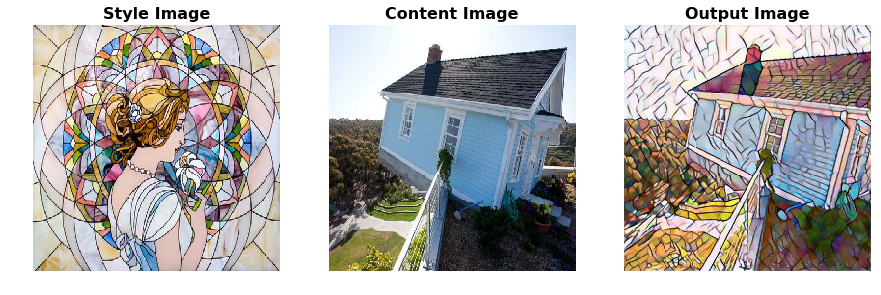

Stylize One Test Sample took: 31.031081914901733 sec.



In [4]:
sst = tic()
!python SlowStyleTransfer/slow_style_main.py sst --test_mode $True --style_name $style_name \
                        --content_name $content_name --output_name $output_name \
                        --print_freq $0 --checkpoint_path $pth --saved_model $saved_model
display_example(style_name, content_name, output_name)
toc(sst, "Stylize One Test Sample")

### 2.3 Stylize some contents with available style targets

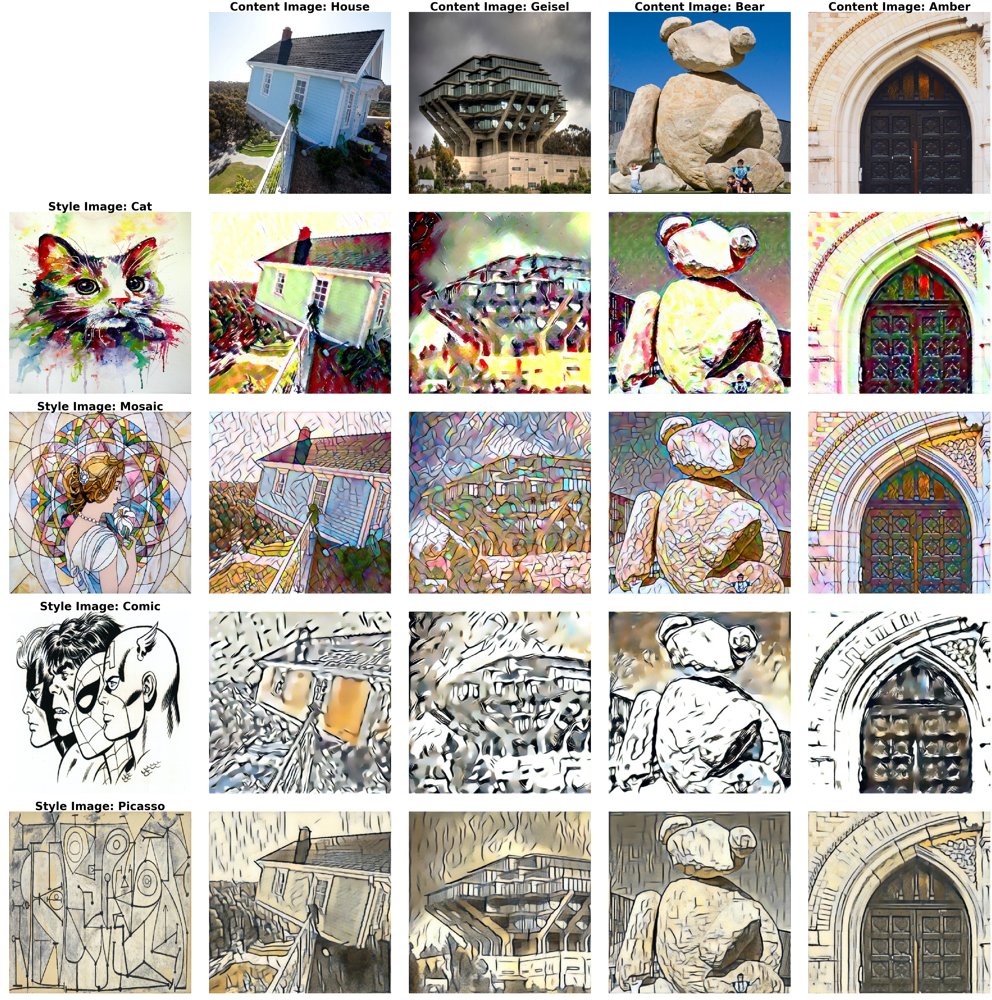

Stylize Multiple Contents took: 13.221654891967773 sec.



In [5]:
sst = tic()
Plot()
toc(sst, "Stylize Multiple Contents")

<div class="alert alert-block alert-success">
<h2><center>Real-Time Style Transfer</center></h2>

For this part, we will implement the fast style transfer based on the architecture and techniques introduced in [this paper](https://arxiv.org/pdf/1508.06576.pdf).

The main structure we utilize is demonstrated below
![model](https://raw.githubusercontent.com/kwanmolee/-Style-Transfer-Learning/master/model.png)
</div>

### 1. Experiment Preparation
### 1.1 Import Modules

In [1]:
import sys
sys.path.append("./FastStyleTransfer")
import fast_style_transfer as fst

### 1.2 Set Up Attributes and Arguments
>#### Arguments for training model for a specific style
- **style_img**: path of style image
- **epoch**: number of epochs to run during training (default: 2)
- **batch_size**: number of samples of a batch during training(default: 4)
- **dataset**: path to the dataset (default: "/datasets/COCO-2015")
- **style_size**: size of the style image (default: original size of the style image)
- **save_model_dir**: directory where the trained models would be saved (default: "./FastStyleTransfer/saved_models")
- **checkpoint_model_dir**: directory where the checkpoints generated during training would be stored    
(default: "./FastStyleTransfer/checkpoints") 
- **image_size**: size of training image (default: $256\times256$)
- **random_seed**: number to initialize the random number generator (default: 42)
- **content_weight**: the content weight of the loss function (default: 1e5)
- **style_weight**: the style_weight of the loss function (default: 1e10)
- **lr**: learning rate (default:1e-3)
- **log_interval**: the number of samples to be processed between two state information (default: 500)
>
>#### Arguments for generating a new image with given content and style
- **content**: name of the content image (default: "arch")
- **style**: name of the selected style (default: "mosaic")
- **content_scale**: scale of the content image (default: None)
- **output_dir**: dirctory where the generated image would be stored (default: ./FastStyleTransfer/output_images")
>
>#### Argument for showing result
- **style_list**: list of name of styles selected (default: ["cat","comic","mosaic","picasso"])
- **content_list**: list of name of content selected (default: ["arch","bear","geisel","house"])
>
>#### Argument for real-time style transfer
- **style_list**: a list of name of three selected style (default: ["mosaic", "comic", "picasso"]) 

### 2. Add User Arguments and Implement Fast Style Transfer
<div class="alert alert-block alert-danger">
<b>tips:</b>current available style models: "cat", "comic","mosaic","picasso". If want to use other styles, please train a model for that style using method "train" first.
</div>

### 2.1 Train a Model for a Given Style Image

In [2]:
# all codes in this block are comment out because we won't train model this time

# # set the path of the style image
# style_img_path = "./FastStyleTransfer/style_images/cat.jpg"
# #train the model using default setting
# fst.train(style_img_path)

### 2.2 Generate an Image With Selected Content and Style

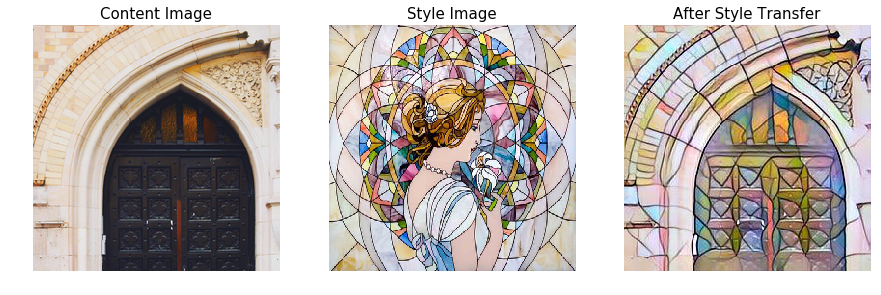

In [3]:
#select content and style
style = "mosaic"
content = "arch"
fst.evaluate(content, style)

### 2.3 Show Combination of Different Content Images and Style Images in a Grid

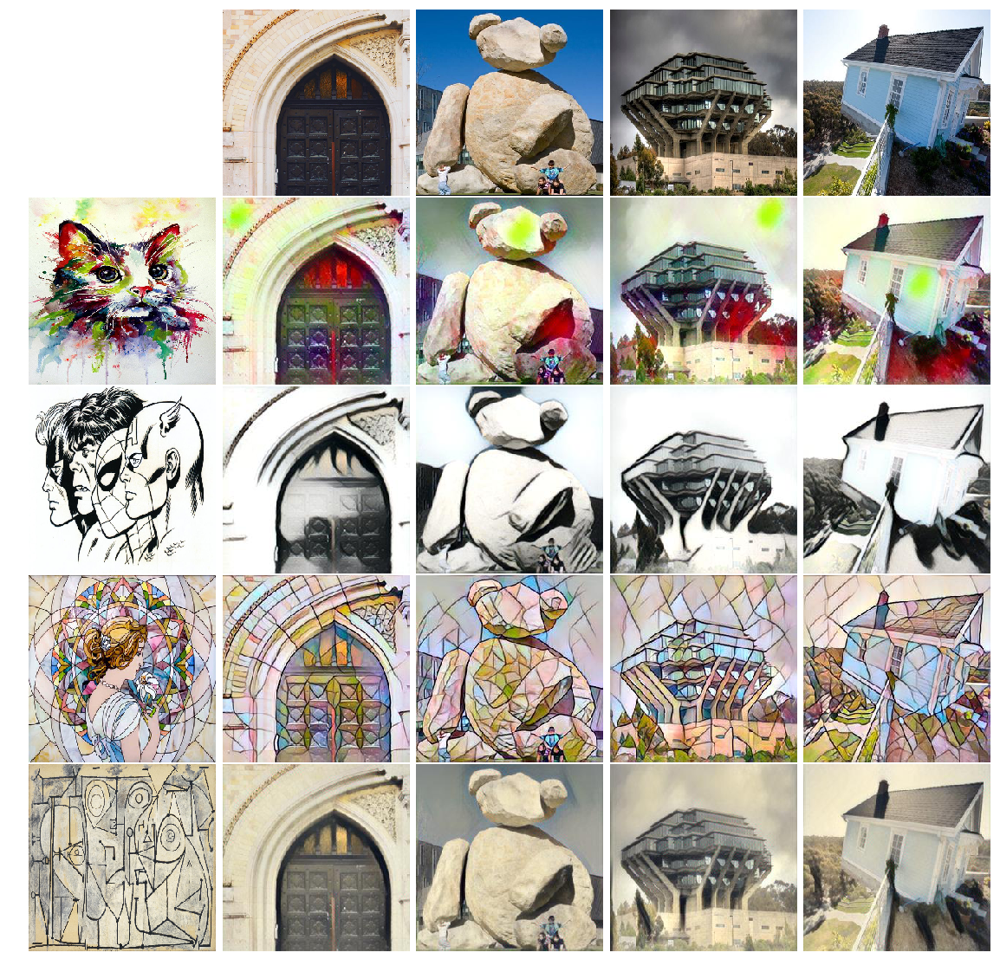

In [6]:
fst.showresult() # default setting is used here (style = ["cat","comic","mosaic","picasso"] and content = ["arch","bear","geisel","house"])

### 2.4 Real-Time Style Transfer 
**To run this function, a web camera is needed**

In [5]:
#the command is comment out because the MLDSP sever has no web camera

#realtime_stylize()

A screen shot of the realtime style transfer demo run locally is given below:   
![demo](./FastStyleTransfer/real_time.jpg)
